| Converting Continuous variables to Discrete Categorical variables (If applicable) |Hyperparameter GridSearch

In [77]:
import json
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import GradientBoostingRegressor,RandomForestRegressor,AdaBoostRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
import lightgbm as lgbm

import numpy as np

import pandas as pd
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
import numpy as np
import matplotlib.pyplot as plt
import shap
from sklearn.model_selection import KFold
import matplotlib.colors as mcolors
import matplotlib

In [78]:
black = mcolors.CSS4_COLORS["black"]
lime = mcolors.CSS4_COLORS["lime"]
aqua = mcolors.CSS4_COLORS["aqua"]
magenta = mcolors.CSS4_COLORS["magenta"]
red = mcolors.CSS4_COLORS["red"]

In [3]:
path = "./data/feature-selection/"
with open(path + "dataset-wo-outliers-shap_fs-3.json", 'r') as f:
    data_fs_3 = json.load(f)

with open(path + "dataset-wo-outliers-shap_fs-4.json", 'r') as f:
    data_fs_4 = json.load(f)

df_fs_3 = pd.DataFrame.from_dict(data_fs_3,orient="columns")
df_fs_4 = pd.DataFrame.from_dict(data_fs_4,orient="columns")

# Feature Encoding 

This sections aims to improve the model's prediction capability by applying different feature encoding techniques, hopefully reducing any noise within observations and boosting performance.

## Many categories in features - few categories

This technique employs feature distribution analysis to reduce the number of categories in categorical features to at most 3 categories. Categories will be transformed to reduce the number of categories in the relevant features

### Many-categories features (Sample)

Let's try reducing only a subset of the selected features to be reduced in terms of the number of categories.

In [4]:
df_few_cats_fs_3 = df_fs_3.copy()
df_few_cats_fs_4 = df_fs_4.copy()
df_few_cats_fs_4_2 = df_fs_4.copy()

In [5]:
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearBuilt"] < 1930, "YearBuilt"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["YearBuilt"] >= 1930) & (df_few_cats_fs_4_2["YearBuilt"] <= 1985), "YearBuilt"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearBuilt"] > 1985, "YearBuilt"] = 3

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearRemodAdd"] < 1960, "YearRemodAdd"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["YearRemodAdd"] >= 1960) & (df_few_cats_fs_4_2["YearRemodAdd"] <= 1985), "YearRemodAdd"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearRemodAdd"] > 1985, "YearRemodAdd"] = 3

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["TotalBsmtSF"] < 250, "TotalBsmtSF"] = 0
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["TotalBsmtSF"] >= 250) & (df_few_cats_fs_4_2["TotalBsmtSF"] <= 2250), "TotalBsmtSF"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["TotalBsmtSF"] > 2250, "TotalBsmtSF"] = 2

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["OverallCond"] < 4.1, "OverallCond"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["OverallCond"] >= 4.1) & (df_few_cats_fs_4_2["OverallCond"] <= 5.8), "OverallCond"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["OverallCond"] > 5.8, "OverallCond"] = 3


#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["GarageType_enc"] < 3, "GarageType_enc"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["GarageType_enc"] >=3, "GarageType_enc"] = 2


#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinSF1"] < 250, "BsmtFinSF1"] = 0
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinSF1"] >=250, "BsmtFinSF1"] = 1

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["LotArea"] < 25000, "LotArea"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["LotArea"] >=25000, "LotArea"] = 2



#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["ExterQual_enc"] < 1.5, "ExterQual_enc"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["ExterQual_enc"] >= 1.5) & (df_few_cats_fs_4_2["ExterQual_enc"] <= 2.5), "ExterQual_enc"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["ExterQual_enc"] > 2.5, "ExterQual_enc"] = 3



#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinType1_enc"] < 1, "BsmtFinType1_enc"] = 0
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["BsmtFinType1_enc"] >= 1) & (df_few_cats_fs_4_2["BsmtFinType1_enc"] <= 4), "BsmtFinType1_enc"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinType1_enc"] > 4, "BsmtFinType1_enc"] = 2


#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["Neighborhood_enc"] < 7, "Neighborhood_enc"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["Neighborhood_enc"] >= 7) & (df_few_cats_fs_4_2["Neighborhood_enc"] <= 12.5), "Neighborhood_enc"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["Neighborhood_enc"] > 12.5, "Neighborhood_enc"] = 3



In [6]:

X_few_cats_fs_4_2 = df_few_cats_fs_4_2.drop(["SalePrice"],axis = 1)
y_few_cats_fs_4_2 = df_few_cats_fs_4_2["SalePrice"]

test_size = 0.25
random_state = 43


X_train_few_cats_fs_4_2,X_valid_few_cats_fs_4_2,y_train_few_cats_fs_4_2, y_valid_few_cats_fs_4_2 = train_test_split(
    X_few_cats_fs_4_2.to_numpy(),y_few_cats_fs_4_2.to_numpy(),test_size=test_size,random_state=random_state)




y_train_few_cats_fs_4_2 = y_train_few_cats_fs_4_2.reshape(-1,1)
y_valid_few_cats_fs_4_2 = y_valid_few_cats_fs_4_2.reshape(-1,1)



#Normalize train shap_1 - Shapley Feature Selection

scaler_X_few_cats_fs_4_2 = StandardScaler().fit(X_train_few_cats_fs_4_2)

X_train_few_cats_fs_4_2_norm = scaler_X_few_cats_fs_4_2.transform(X_train_few_cats_fs_4_2)
y_train_few_cats_fs_4_2_norm = np.log(y_train_few_cats_fs_4_2)

#normalize validation shap_1, mean and stddev from training distribution

mean_X_train_few_cats_fs_4_2 = scaler_X_few_cats_fs_4_2.mean_.reshape(1,-1).repeat(X_valid_few_cats_fs_4_2.shape[0],axis=0)

X_valid_few_cats_fs_4_2_norm = (X_valid_few_cats_fs_4_2 - mean_X_train_few_cats_fs_4_2) / scaler_X_few_cats_fs_4_2.scale_
y_valid_few_cats_fs_4_2_norm = np.log(y_valid_few_cats_fs_4_2)

In [7]:
n_estimators = 100
loss = "squared_error"
learning_rate = 0.1
max_depth = 4
random_state = 43
verbose = 0
alpha = 1.5
kernel = "poly"
degree = 4


models = {
    "XGB_shap_1" : [xgb.XGBRegressor(n_estimators=n_estimators, max_depth=max_depth, eta=learning_rate, subsample=0.7, colsample_bytree=0.8,
                     verbose=verbose),
                     X_train_few_cats_fs_4_2_norm,y_train_few_cats_fs_4_2_norm,X_valid_few_cats_fs_4_2_norm,
                     y_valid_few_cats_fs_4_2_norm],
    "LGBM_shap_1" : [lgbm.LGBMRegressor(max_depth=max_depth, learning_rate=learning_rate, n_estimators=n_estimators, random_state=random_state,
                       verbose=-1),
                       X_train_few_cats_fs_4_2_norm,y_train_few_cats_fs_4_2_norm,X_valid_few_cats_fs_4_2_norm,
                     y_valid_few_cats_fs_4_2_norm],
    
}

for model_name,model_tup in models.items():
    #train model with training set
    model_tup[0].fit(model_tup[1],model_tup[2])

    #predict output using validation set
    pred = model_tup[0].predict(model_tup[3])

    #find MSE score 
    mse_score = mean_squared_error(model_tup[4],pred)
    print(f"Model : {model_name}, MSE score in validation set : {mse_score}")

Model : XGB_shap_1, MSE score in validation set : 0.01695766945618902
Model : LGBM_shap_1, MSE score in validation set : 0.018851998511590508


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [07:18:32] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "verbose" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


### Many-categories features (Complete)

Now, we try with the full set of many categories features.

In [8]:
df_few_cats_fs_4 = df_few_cats_fs_4_2.copy()

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["KitchenQual_enc"] < 1.5, "KitchenQual_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["KitchenQual_enc"] >= 1.5) & (df_few_cats_fs_4["KitchenQual_enc"] <= 2.5), "KitchenQual_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["KitchenQual_enc"] > 3.5, "KitchenQual_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["SaleCondition_enc"] < 3.2, "SaleCondition_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["SaleCondition_enc"] >= 3.2) & (df_few_cats_fs_4["SaleCondition_enc"] <= 4.7), "KitchenQual_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["SaleCondition_enc"] > 4.7, "SaleCondition_enc"] = 3

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["GarageYrBlt"] < 1500, "GarageYrBlt"] = 0
df_few_cats_fs_4.loc[df_few_cats_fs_4["GarageYrBlt"] >= 1500, "GarageYrBlt"] = 1

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["OpenPorchSF"] < 50, "OpenPorchSF"] = 0
df_few_cats_fs_4.loc[df_few_cats_fs_4["OpenPorchSF"] >= 50, "OpenPorchSF"] = 1


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["MSZoning_enc"] < 2.5, "MSZoning_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["MSZoning_enc"] >= 2.5) & (df_few_cats_fs_4["MSZoning_enc"] <= 3.5), "MSZoning_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["MSZoning_enc"] > 3.5, "MSZoning_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["WoodDeckSF"] < 85, "WoodDeckSF"] = 0
df_few_cats_fs_4.loc[df_few_cats_fs_4["WoodDeckSF"] >= 85, "WoodDeckSF"] = 1


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["Exterior1st_enc"] < 5.2, "Exterior1st_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["Exterior1st_enc"] >= 5.2) & (df_few_cats_fs_4["Exterior1st_enc"] <= 10), "Exterior1st_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["Exterior1st_enc"] > 10, "Exterior1st_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtQual_enc"] < 1.5, "BsmtQual_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["BsmtQual_enc"] >= 1.5) & (df_few_cats_fs_4["BsmtQual_enc"] <= 3), "BsmtQual_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtQual_enc"] > 3, "BsmtQual_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtExposure_enc"] < 2.5, "BsmtExposure_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["BsmtExposure_enc"] >= 2.5) & (df_few_cats_fs_4["BsmtExposure_enc"] <= 3.5), "BsmtExposure_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtExposure_enc"] > 3.5, "BsmtExposure_enc"] = 3

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["LotFrontage"] < 60, "LotFrontage"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["LotFrontage"] >= 60) & (df_few_cats_fs_4["LotFrontage"] <= 80), "LotFrontage"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["LotFrontage"] > 80, "LotFrontage"] = 3

In [9]:
X_few_cats_fs_4 = df_few_cats_fs_4.drop(["SalePrice"],axis = 1)
y_few_cats_fs_4 = df_few_cats_fs_4["SalePrice"]

test_size = 0.25
random_state = 43


X_train_few_cats_fs_4,X_valid_few_cats_fs_4,y_train_few_cats_fs_4, y_valid_few_cats_fs_4 = train_test_split(
    X_few_cats_fs_4.to_numpy(),y_few_cats_fs_4.to_numpy(),test_size=test_size,random_state=random_state)




y_train_few_cats_fs_4 = y_train_few_cats_fs_4.reshape(-1,1)
y_valid_few_cats_fs_4 = y_valid_few_cats_fs_4.reshape(-1,1)



#Normalize train shap_1 - Shapley Feature Selection

scaler_X_few_cats_fs_4 = StandardScaler().fit(X_train_few_cats_fs_4)

X_train_few_cats_fs_4_norm = scaler_X_few_cats_fs_4.transform(X_train_few_cats_fs_4)
y_train_few_cats_fs_4_norm = np.log(y_train_few_cats_fs_4)

#normalize validation shap_1, mean and stddev from training distribution

mean_X_train_few_cats_fs_4 = scaler_X_few_cats_fs_4.mean_.reshape(1,-1).repeat(X_valid_few_cats_fs_4.shape[0],axis=0)

X_valid_few_cats_fs_4_norm = (X_valid_few_cats_fs_4 - mean_X_train_few_cats_fs_4) / scaler_X_few_cats_fs_4.scale_
y_valid_few_cats_fs_4_norm = np.log(y_valid_few_cats_fs_4)

In [10]:
n_estimators = 100
loss = "squared_error"
learning_rate = 0.1
max_depth = 4
random_state = 43
verbose = 0
alpha = 1.5
kernel = "poly"
degree = 4


models = {
    "XGB_shap_1" : [xgb.XGBRegressor(n_estimators=n_estimators, max_depth=max_depth, eta=learning_rate, subsample=0.7, colsample_bytree=0.8,
                     verbose=verbose),
                     X_train_few_cats_fs_4_norm,y_train_few_cats_fs_4_norm,X_valid_few_cats_fs_4_norm,
                     y_valid_few_cats_fs_4_norm],
    "LGBM_shap_1" : [lgbm.LGBMRegressor(max_depth=max_depth, learning_rate=learning_rate, n_estimators=n_estimators, random_state=random_state,
                       verbose=-1),
                       X_train_few_cats_fs_4_norm,y_train_few_cats_fs_4_norm,X_valid_few_cats_fs_4_norm,
                     y_valid_few_cats_fs_4_norm],
    
}

for model_name,model_tup in models.items():
    #train model with training set
    model_tup[0].fit(model_tup[1],model_tup[2])

    #predict output using validation set
    pred = model_tup[0].predict(model_tup[3])

    #find MSE score 
    mse_score = mean_squared_error(model_tup[4],pred)
    print(f"Model : {model_name}, MSE score in validation set : {mse_score}")

Model : XGB_shap_1, MSE score in validation set : 0.017593187996005198
Model : LGBM_shap_1, MSE score in validation set : 0.01861952686793827


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [07:18:32] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "verbose" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


<table>
    <thead>
        <tr>
            <th></th>
            <th colspan = 2><center>Metric: Mean Squared Error (MSE) </center></th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td ><center>ML Model</center></td>
            <td ><center>XGBRegressor</center></td>
            <td><center>LightGBMRegressor</center></td>
        </tr>
        <tr>
            <td><center>Baseline Dataset Norm Ln(y)</center></td>
            <td><center><span style="text-decoration: underline;">0.01577</span></center></td>
            <td><center><span style="text-decoration: underline;">0.01605</span></center></td>
        </tr>
        <tr>
            <td><center>Shap Model 3</center></td>
            <td><center>0.0159</center></td>
            <td><center><strong>0.01562</strong></center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4</center></td>
            <td><center><strong>0.015552</strong></center></td>
            <td><center>0.0163</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4 - Sample Feature Encoding</center></td>
            <td><center>0.01695</center></td>
            <td><center>0.01885</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4 - Complete Feature Encoding</center></td>
            <td><center>0.01759</center></td>
            <td><center>0.01861</center></td>
        </tr>
    </tbody>
</table>

Conclusion: This approach for improving Model's predicting capability was not useful, we discard these data processing steps for the dataset.

## One-Hot Encoding

This approach consists on one-hot encoding categorical variables to see if any improvement in model's performance arises.

In [11]:
df_one_hot_fs_3 = df_fs_3.copy()
df_one_hot_fs_4 = df_fs_4.copy()

In [12]:
df_one_hot_fs_4.select_dtypes(["int64"]).columns.drop(["SalePrice"])

Index(['OverallQual', 'GrLivArea', 'GarageCars', 'YearBuilt', 'YearRemodAdd',
       'TotalBsmtSF', 'OverallCond', 'GarageType_enc', 'BsmtFinSF1', 'LotArea',
       'ExterQual_enc', 'GarageArea', '1stFlrSF', 'BsmtFinType1_enc',
       'Neighborhood_enc', 'Fireplaces', 'KitchenQual_enc',
       'SaleCondition_enc', 'CentralAir_enc', 'OpenPorchSF', 'MSZoning_enc',
       'WoodDeckSF', 'Exterior1st_enc', 'BsmtQual_enc', 'BsmtExposure_enc'],
      dtype='object')

In [13]:
df_one_hot_fs_4[['OverallQual']].value_counts()

OverallQual
5              373
6              325
7              288
8              126
4              104
9               24
3               19
10               8
2                3
1                2
Name: count, dtype: int64

In [14]:
df_one_hot_fs_4[['GarageCars']].value_counts()

GarageCars
2             726
1             344
3             124
0              73
4               5
Name: count, dtype: int64

In [15]:
pd.get_dummies(df_one_hot_fs_4[['OverallQual', 'GarageCars']].astype("category"),prefix=None,dtype=float)

,OverallQual_1,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,GarageCars_0,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4
0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1267,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1268,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1269,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1270,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [16]:
df_one_hot_fs_4.select_dtypes(["int64"]).shape

(1272, 26)

In [17]:
df_one_hot_fs_4.select_dtypes(["float"]).shape

(1272, 2)

In [18]:
df_one_hot_fs_4.shape

(1272, 28)

In [19]:
df_one_hot_encode_fs_4 = pd.get_dummies(df_one_hot_fs_4.select_dtypes(["int64"]).drop(["SalePrice"],axis=1).astype("category"),dtype=float)
df_one_hot_encode_fs_4 = pd.concat([df_one_hot_encode_fs_4,df_one_hot_fs_4.select_dtypes(["float"]),df_one_hot_fs_4["SalePrice"]],axis=1)

In [20]:
X_one_hot_encode_fs_4 = df_one_hot_encode_fs_4.drop(["SalePrice"],axis = 1)
y_one_hot_encode_fs_4 = df_one_hot_encode_fs_4["SalePrice"]

test_size = 0.25
random_state = 43


X_train_one_hot_encode_fs_4,X_valid_one_hot_encode_fs_4,y_train_one_hot_encode_fs_4, y_valid_one_hot_encode_fs_4 = train_test_split(
    X_one_hot_encode_fs_4.to_numpy(),y_one_hot_encode_fs_4.to_numpy(),test_size=test_size,random_state=random_state)




y_train_one_hot_encode_fs_4 = y_train_one_hot_encode_fs_4.reshape(-1,1)
y_valid_one_hot_encode_fs_4 = y_valid_one_hot_encode_fs_4.reshape(-1,1)



#Normalize train shap_1 - Shapley Feature Selection

scaler_X_one_hot_encode_fs_4 = StandardScaler().fit(X_train_one_hot_encode_fs_4)

X_train_one_hot_encode_fs_4_norm = scaler_X_one_hot_encode_fs_4.transform(X_train_one_hot_encode_fs_4)
y_train_one_hot_encode_fs_4_norm = np.log(y_train_one_hot_encode_fs_4)

#normalize validation shap_1, mean and stddev from training distribution

mean_X_train_one_hot_encode_fs_4 = scaler_X_one_hot_encode_fs_4.mean_.reshape(1,-1).repeat(X_valid_one_hot_encode_fs_4.shape[0],axis=0)

X_valid_one_hot_encode_fs_4_norm = (X_valid_one_hot_encode_fs_4 - mean_X_train_one_hot_encode_fs_4) / scaler_X_one_hot_encode_fs_4.scale_
y_valid_one_hot_encode_fs_4_norm = np.log(y_valid_one_hot_encode_fs_4)

In [21]:
n_estimators = 100
loss = "squared_error"
learning_rate = 0.1
max_depth = 4
random_state = 43
verbose = 0
alpha = 1.5
kernel = "poly"
degree = 4

tree_estimator = DecisionTreeRegressor(criterion=loss,max_depth=max_depth,random_state=random_state)

models = {
    "XGB_one_hot" : [xgb.XGBRegressor(n_estimators=n_estimators, max_depth=max_depth, eta=learning_rate, subsample=0.7, colsample_bytree=0.8,
                     verbose=verbose),
                     X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "LGBM_one_hot" : [lgbm.LGBMRegressor(max_depth=max_depth, learning_rate=learning_rate, n_estimators=n_estimators, random_state=random_state,
                       verbose=-1),
                       X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],    
    #"ridge_one_hot": [Pipeline([('poly', PolynomialFeatures(degree=degree)),
    #              ('ridge', Ridge(alpha=alpha, random_state=random_state))]),
    #              X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
    #                 y_valid_one_hot_encode_fs_4_norm],
    "SVM_one_hot": [SVR(kernel=kernel,degree=degree, C= alpha),
         X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "Grad_Boost_one_hot":[GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate, max_depth=max_depth,
                                                    random_state=random_state,
                              verbose=verbose),
                              X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "RandomForest_one_hot": [RandomForestRegressor(n_estimators=n_estimators,criterion=loss,max_depth=max_depth,random_state=random_state,
                          verbose=verbose),
                          X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "Adaboost_one_hot" : [AdaBoostRegressor(estimator=tree_estimator,n_estimators=n_estimators,learning_rate=learning_rate,loss="square",
                                            random_state=random_state),
                                            X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm]
    
}

for model_name,model_tup in models.items():
    #train model with training set
    model_tup[0].fit(model_tup[1],model_tup[2])

    #predict output using validation set
    pred = model_tup[0].predict(model_tup[3])

    #find MSE score 
    mse_score = mean_squared_error(model_tup[4],pred)
    print(f"Model : {model_name}, MSE score in validation set : {mse_score}")


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [07:18:32] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "verbose" } are not used.

  warnings.warn(smsg, UserWarning)


Model : XGB_one_hot, MSE score in validation set : 0.02698230602255613
Model : LGBM_one_hot, MSE score in validation set : 0.028847269321232497


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model : SVM_one_hot, MSE score in validation set : 0.13783191755352062


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\ensemble\_gb.py:668: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)  # TODO: Is this still required?


Model : Grad_Boost_one_hot, MSE score in validation set : 0.02774110669793772


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model : RandomForest_one_hot, MSE score in validation set : 0.043245979152531526


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model : Adaboost_one_hot, MSE score in validation set : 0.037864618802740516


<table>
    <thead>
        <tr>
            <th></th>
            <th colspan = 6><center>Metric: Mean Squared Error (MSE) </center></th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td ><center>ML Model</center></td>
            <td ><center>XGBRegressor</center></td>
            <td><center>LightGBMRegressor</center></td>
            <td><center>SVM</center></td>
            <td><center>Gradient Boosting</center></td>
            <td><center>Random Forest</center></td>
            <td><center>AdaBoost</center></td>
        </tr>
        <tr>
            <td><center>Baseline Dataset Norm Ln(y)</center></td>
            <td><center><span style="text-decoration: underline;">0.01577</span></center></td>
            <td><center><span style="text-decoration: underline;">0.01605</span></center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 3</center></td>
            <td><center>0.0159</center></td>
            <td><center><strong>0.01562</strong></center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4</center></td>
            <td><center><strong>0.015552</strong></center></td>
            <td><center>0.0163</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
        </tr>
        <tr>
            <td><center>One-Hot Encode </center></td>
            <td><center>0.0269</center></td>
            <td><center>0.028</center></td>
            <td><center>0.137</center></td>
            <td><center>0.0277</center></td>
            <td><center>0.0432</center></td>
            <td><center>0.0378</center></td>
        </tr>
    </tbody>
</table>

Conclusion: One-hot encoding did not improve the previous results. We discard these datasets for future experiments

# Hyperparameter GridSearch

Shapley feature selection dataframe 3 - Normalization Dataset

In [22]:
# Dataframe to Numpy array Dataset

X_df_fs_3 = df_fs_3.drop(["SalePrice"],axis = 1)
y_df_fs_3 = df_fs_3["SalePrice"]

test_size = 0.25
random_state = 43


X_train_fs_3,X_valid_fs_3,y_train_fs_3, y_valid_fs_3 = train_test_split(
    X_df_fs_3.to_numpy(),y_df_fs_3.to_numpy(),test_size=test_size,random_state=random_state)


y_train_fs_3 = y_train_fs_3.reshape(-1,1)
y_valid_fs_3 = y_valid_fs_3.reshape(-1,1)



#Normalize train FS 3

scaler_X_fs_3 = StandardScaler().fit(X_train_fs_3)

X_train_fs_3_norm = scaler_X_fs_3.transform(X_train_fs_3)
y_train_fs_3_norm = np.log(y_train_fs_3)

#normalize validation FS 3, mean and stddev from training distribution

mean_X_train_fs_3 = scaler_X_fs_3.mean_.reshape(1,-1).repeat(X_valid_fs_3.shape[0],axis=0)

X_valid_fs_3_norm = (X_valid_fs_3 - mean_X_train_fs_3) / scaler_X_fs_3.scale_
y_valid_fs_3_norm = np.log(y_valid_fs_3)

#-------------------------------------------------------------------------------------------------------------

Shapley feature selection dataframe 4 - Normalization Dataset

In [23]:
# Dataframe to Numpy array Dataset

X_df_fs_4 = df_fs_4.drop(["SalePrice"],axis = 1)
y_df_fs_4 = df_fs_4["SalePrice"]

X_train_fs_4,X_valid_fs_4,y_train_fs_4, y_valid_fs_4 = train_test_split(
    X_df_fs_4.to_numpy(),y_df_fs_4.to_numpy(),test_size=test_size,random_state=random_state)


y_train_fs_4 = y_train_fs_4.reshape(-1,1)
y_valid_fs_4 = y_valid_fs_4.reshape(-1,1)



#Normalize train FS 4

scaler_X_fs_4 = StandardScaler().fit(X_train_fs_4)

X_train_fs_4_norm = scaler_X_fs_4.transform(X_train_fs_4)
y_train_fs_4_norm = np.log(y_train_fs_4)

#normalize validation FS 4, mean and stddev from training distribution

mean_X_train_fs_4 = scaler_X_fs_4.mean_.reshape(1,-1).repeat(X_valid_fs_4.shape[0],axis=0)

X_valid_fs_4_norm = (X_valid_fs_4 - mean_X_train_fs_4) / scaler_X_fs_4.scale_
y_valid_fs_4_norm = np.log(y_valid_fs_4)

#-------------------------------------------------------------------------------------------------------------

## XGBRegressor Hyperparameter Tuning

Shapley dataframe 3 - XGBRegressor

In [24]:
param_grid={
    'n_estimators':[100,500,900,1000,1100,1500],
    'eta':[0.05,0.08,0.1,0.15],
    'booster':['gbtree','gblinear'],
    'max_depth':[3,5,10],
    'min_child_weight':[1,2],
    "gamma" : [0.001,0.01,0.1,0.2],
    "subsample" : [0.5,1],
    "colsample_bytree" : [0.5,1],
    "lambda" : [1,2,3],
    "alpha" : [0,0.5,1]
}

In [25]:
""" 
model_xgb_fs_3 = xgb.XGBRegressor(seed=random_state)

gs_xgb_fs_3 = GridSearchCV(model_xgb_fs_3,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
gs_xgb_fs_3.fit(X_train_fs_3_norm,y_train_fs_3_norm)

pred = gs_xgb_fs_3.predict(X_valid_fs_3_norm)

mse_score = mean_squared_error(y_valid_fs_3_norm,pred)
print(f"Model : {model_xgb_fs_3.__class__}, MSE score in validation set : {mse_score}") """

' \nmodel_xgb_fs_3 = xgb.XGBRegressor(seed=random_state)\n\ngs_xgb_fs_3 = GridSearchCV(model_xgb_fs_3,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")\ngs_xgb_fs_3.fit(X_train_fs_3_norm,y_train_fs_3_norm)\n\npred = gs_xgb_fs_3.predict(X_valid_fs_3_norm)\n\nmse_score = mean_squared_error(y_valid_fs_3_norm,pred)\nprint(f"Model : {model_xgb_fs_3.__class__}, MSE score in validation set : {mse_score}") '

Shapley dataframe 4 - XGBRegressor

In [26]:
param_grid={
    'n_estimators':[100,500,900,1000,1100,1500],
    'eta':[0.05,0.08,0.1,0.15],
    'booster':['gbtree','gblinear'],
}

In [27]:
n_estimators = [100,500]#,900,1000,1100,1500]
eta = [0.05,0.08]#,0.1,0.15]
booster = ['gbtree','gblinear']


In [28]:
kf= KFold(n_splits=5,random_state=43,shuffle=True)

In [29]:
for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):
    print(f"Fold {i}:")
    print(f"  Train: index={train_index[:10]}")
    print(f"  Test:  index={test_index[:10]}")
    

Fold 0:
  Train: index=[ 0  2  3  4  5  6  7  8  9 10]
  Test:  index=[ 1 11 15 17 24 27 29 34 36 47]
Fold 1:
  Train: index=[ 1  2  3  4  5  6  7  8 10 11]
  Test:  index=[ 0  9 12 19 21 35 38 49 61 63]
Fold 2:
  Train: index=[ 0  1  5  6  7  8  9 10 11 12]
  Test:  index=[ 2  3  4 18 20 31 41 42 44 45]
Fold 3:
  Train: index=[ 0  1  2  3  4  5  7  9 11 12]
  Test:  index=[ 6  8 10 13 14 22 25 26 28 30]
Fold 4:
  Train: index=[ 0  1  2  3  4  6  8  9 10 11]
  Test:  index=[ 5  7 16 23 32 33 40 46 51 52]


In [30]:
ls = [(5,10),(2,4),(1,3)]
t = sorted(
    ls, 
    key=lambda x: x[1],
    reverse=False
)

In [31]:
ls = [1,3,4]
np.argmax(ls)

np.int64(2)

In [32]:
""" best_model_score = 100.0
best_model = None


for n_est in n_estimators:
    for lr in eta:
        for boost in booster:

            ls_candidate_models = []
            ls_candidate_scores = []

            
            for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):
                kf_X_train, kf_y_train, kf_X_test, kf_y_test = X_train_fs_4_norm[train_index],y_train_fs_4_norm[train_index], X_train_fs_4_norm[test_index],y_train_fs_4_norm[test_index]
                
                #set model
                model = xgb.XGBRegressor(
                n_estimators=n_est,eta=lr,booster=boost, seed=random_state)

                model.fit(kf_X_train,kf_y_train)

                y_pred =model.predict(kf_X_test)

                mse_score_k = mean_squared_error(kf_y_test,y_pred)

                ls_candidate_models.append(model)
                ls_candidate_scores.append(mse_score_k)


                #print(f"Estimators : {n_est}, lr : {lr}, booster : {boost}, CV: {i+1}, MSE test score : {mse_score_k}")

            if np.average(ls_candidate_scores) < best_model_score:
                print(f"past best model score  : {best_model_score}, avg new best : {np.average(ls_candidate_scores)}")
                idx_best = np.argmax(ls_candidate_scores)
                best_model = ls_candidate_models[idx_best]
                print(f"new best indv score: {np.max(ls_candidate_scores)}")
                best_model_score = np.average(ls_candidate_scores)
 """

' best_model_score = 100.0\nbest_model = None\n\n\nfor n_est in n_estimators:\n    for lr in eta:\n        for boost in booster:\n\n            ls_candidate_models = []\n            ls_candidate_scores = []\n\n            \n            for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):\n                kf_X_train, kf_y_train, kf_X_test, kf_y_test = X_train_fs_4_norm[train_index],y_train_fs_4_norm[train_index], X_train_fs_4_norm[test_index],y_train_fs_4_norm[test_index]\n                \n                #set model\n                model = xgb.XGBRegressor(\n                n_estimators=n_est,eta=lr,booster=boost, seed=random_state)\n\n                model.fit(kf_X_train,kf_y_train)\n\n                y_pred =model.predict(kf_X_test)\n\n                mse_score_k = mean_squared_error(kf_y_test,y_pred)\n\n                ls_candidate_models.append(model)\n                ls_candidate_scores.append(mse_score_k)\n\n\n                #print(f"Estimators : {n_est},

In [33]:
best_model = None
best_model_score = 100.0

In [34]:
""" for n_est in n_estimators:
    for lr in eta:
        for boost in booster:
            #set model
            """ model = xgb.XGBRegressor(
                n_estimators=n_est,eta=lr,booster=boost, seed=random_state) """
            for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):
                kf_X_train, kf_y_train, kf_X_test, kf_y_test = X_train_fs_4_norm[train_index],y_train_fs_4_norm[train_index], X_train_fs_4_norm[test_index],y_train_fs_4_norm[test_index]
                
                model = xgb.XGBRegressor(
                n_estimators=n_est,eta=lr,booster=boost, seed=random_state)
                model.fit(kf_X_train,kf_y_train)

                y_pred =model.predict(kf_X_test)

                mse_score_k = mean_squared_error(kf_y_test,y_pred)

                #print(f"Estimators : {n_est}, lr : {lr}, booster : {boost}, CV: {i+1}, MSE test score : {mse_score_k}")

            if mse_score_k < best_model_score:
                best_model = model
 """

SyntaxError: invalid syntax (1363427548.py, line 5)

In [ ]:
""" 
model = xgb.XGBRegressor(seed=random_state)

reg = GridSearchCV(model,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
reg.fit(X_train_fs_4_norm,y_train_fs_4_norm)

pred = reg.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}") """

Fitting 5 folds for each of 41472 candidates, totalling 207360 fits


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:09:28] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:09:28] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:09:28] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.014710830657054847


In [ ]:

model_xgb_fs_4 = model

gs_xgb_fs_4 = reg
#gs_xgb_fs_4.fit(X_train_fs_4_norm,y_train_fs_4_norm)

pred = gs_xgb_fs_4.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model_xgb_fs_4.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.014710830657054847


In [ ]:
gs_xgb_fs_4.best_estimator_.get_params()["alpha"]

0

In [68]:
best_params_xgb_fs_4 = {
    "n_estimators" : 1100,
    "eta" : 0.05,
    "booster" : "gbtree",
    "max_depth" : 3,
    "min_child_weight" : 1,
    "gamma" : 0.001,
    "subsample" : 0.5,
    "colsample_bytree" : 0.5,
    "lambda" : 1,
    "alpha" : 0,
    "seed" : random_state
}

xgb_fs_4_best_params_model = xgb.XGBRegressor(**best_params_xgb_fs_4)

xgb_fs_4_best_params_model.fit(X_train_fs_4_norm,y_train_fs_4_norm)

pred = xgb_fs_4_best_params_model.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {xgb_fs_4_best_params_model.__class__}, MSE score in validation set : {mse_score}") 

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.014710830657054847


XGBRegressor 4 - No normalization

In [71]:
xgb_model_fs_4_no_norm = xgb.XGBRegressor(**best_params_xgb_fs_4)

xgb_model_fs_4_no_norm.fit(X_train_fs_4,np.log(y_train_fs_4))

pred = xgb_model_fs_4_no_norm.predict(X_valid_fs_4)

mse_score = mean_squared_error(np.log(y_valid_fs_4),pred)
print(f"Model : {xgb_model_fs_4_no_norm.__class__}, MSE score in validation set : {mse_score}") 

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.014710830657054847


'n_estimators':[100,500,900,1000,1100,1500], 1100
    'eta':[0.05,0.08,0.1,0.15],   0.05
    'booster':['gbtree','gblinear'],   gbtree
    'max_depth':[3,5,10],     3
    'min_child_weight':[1,2],  1
    "gamma" : [0.001,0.01,0.1,0.2], .001  
    "subsample" : [0.5,1],   0.5
    "colsample_bytree" : [0.5,1],   0.5
    "lambda" : [1,2,3],     1
    "alpha" : [0,0.5,1]       0

In [ ]:
pred = best_model.predict(X_valid_fs_4_norm) #based on avg model cv preiction

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.015191560155207876


In [ ]:
pred = best_model.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.015188425992898071


In [ ]:
pred = reg.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.015124262501459255


In [ ]:
reg.best_estimator_.get_params()

100

In [ ]:
reg.cv_results_["mean_test_score"]



array([-0.02002368, -0.01950986, -0.01951297, -0.01951297, -0.01951297,
       -0.01951297, -0.01991346, -0.0198042 , -0.0198042 , -0.0198042 ,
       -0.0198042 , -0.0198042 , -0.01925011, -0.01926   , -0.01926   ,
       -0.01926   , -0.01926   , -0.01926   , -0.0198129 , -0.01980298,
       -0.01980298, -0.01980298, -0.01980298, -0.01980298, -0.01587497,
       -0.01566057, -0.01566927, -0.0156698 , -0.01567012, -0.01567059,
       -0.01569419, -0.01566829, -0.01567059, -0.01567063, -0.01567066,
       -0.01567071, -0.01566772, -0.01567002, -0.01567068, -0.0156707 ,
       -0.01567067, -0.01567069, -0.01565   , -0.01567066, -0.01567069,
       -0.0156707 , -0.0156707 , -0.0156707 ])

In [ ]:
reg.cv_results_["rank_test_score"]

array([48, 31, 32, 32, 32, 32, 47, 41, 41, 41, 41, 41, 25, 26, 26, 26, 26,
       26, 46, 36, 36, 36, 36, 36, 24,  2,  5,  6,  8, 10, 23,  4,  9, 11,
       13, 22,  3,  7, 15, 19, 14, 17,  1, 12, 16, 18, 20, 21],
      dtype=int32)

## LightGBM Hyperparameter Tuning

Shapley dataframe 3 - LightGBMRegressor

In [ ]:
param_grid={
    'n_estimators':[100,500,900,1000,1100,1500],
    'learning_rate':[0.01,0.03,0.09,0.13],
    'max_depth':[3,5,10],
    "num_leaves" : [10,31,50],
    "min_data_in_leaf" : [20,30,50],
    "feature_fraction" : [0.5,1.0],
    "bagging_freq" : [0.5],
    "bagging_fraction" : [0.3,0.75],
    "lamda_l1" : [0.0,1.0,2.0],
    "lambda_l2" : [0.0,1.0,2.0]
}

In [ ]:

model_lgbm_fs_3 = lgbm.LGBMRegressor(random_state=random_state,verbose=-1)

gs_lgbm_fs_3 = GridSearchCV(model_lgbm_fs_3,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
gs_lgbm_fs_3.fit(X_train_fs_3_norm,y_train_fs_3_norm)

pred = gs_lgbm_fs_3.predict(X_valid_fs_3_norm)

mse_score = mean_squared_error(y_valid_fs_3_norm,pred)
print(f"Model : {model_lgbm_fs_3.__class__}, MSE score in validation set : {mse_score}")

Shapley dataframe 4 - LightGBMRegressor

In [ ]:

model_lgbm_fs_4 = lgbm.LGBMRegressor(random_state=random_state,verbose=-1)

gs_lgbm_fs_4 = GridSearchCV(model_lgbm_fs_4,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
gs_lgbm_fs_4.fit(X_train_fs_4_norm,y_train_fs_4_norm)

pred = gs_lgbm_fs_4.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model_lgbm_fs_4.__class__}, MSE score in validation set : {mse_score}")

# Submission

## Training models using best hyperparameters found XGB Regressor (Testing purposes)

Dataset with outliers - NaN values filled with mean (without outliers) - outliers row preserved - New Ordinal Encoding applied

In [264]:
path = "./data/outlier-exclusion/"
with open(path + "dataset-wo-outliers-new-ord-enc.json", 'r') as f:
    data_new_ord_enc_w_outliers = json.load(f)


df_new_ord_enc_w_outliers = pd.DataFrame.from_dict(data_new_ord_enc_w_outliers,orient="columns")


X_new_ord_enc_w_outliers = df_new_ord_enc_w_outliers.drop(["SalePrice"],axis = 1).to_numpy()
y_new_ord_enc_w_outliers = np.log(df_new_ord_enc_w_outliers["SalePrice"].to_numpy())

""" test_size = 0.0
random_state = 43


X_train_new_ord_enc_w_outliers,X_valid_new_ord_enc_w_outliers,y_train_new_ord_enc_w_outliers, y_valid_new_ord_enc_w_outliers = train_test_split(
    X_new_ord_enc_w_outliers.to_numpy(),y_new_ord_enc_w_outliers.to_numpy(),test_size=test_size,random_state=random_state)




y_train_new_ord_enc_w_outliers = y_train_new_ord_enc_w_outliers.reshape(-1,1)
y_valid_new_ord_enc_w_outliers = y_valid_new_ord_enc_w_outliers.reshape(-1,1) """


' test_size = 0.0\nrandom_state = 43\n\n\nX_train_new_ord_enc_w_outliers,X_valid_new_ord_enc_w_outliers,y_train_new_ord_enc_w_outliers, y_valid_new_ord_enc_w_outliers = train_test_split(\n    X_new_ord_enc_w_outliers.to_numpy(),y_new_ord_enc_w_outliers.to_numpy(),test_size=test_size,random_state=random_state)\n\n\n\n\ny_train_new_ord_enc_w_outliers = y_train_new_ord_enc_w_outliers.reshape(-1,1)\ny_valid_new_ord_enc_w_outliers = y_valid_new_ord_enc_w_outliers.reshape(-1,1) '

In [265]:
best_params_xgb_fs_4 = {
    "n_estimators" : [1100],
    "eta" : [0.05],
    "booster" : ["gbtree"],
    "max_depth" : [3],
    "min_child_weight" : [1],
    "gamma" : [0.001],
    "subsample" : [0.5],
    "colsample_bytree" : [0.5],
    "lambda" : [1],
    "alpha" : [0],
    "seed" : [random_state]
}

model_w_outliers_new_ord_enc = xgb.XGBRegressor(seed=random_state)

gs_w_outliers_new_ord_enc= GridSearchCV(model_w_outliers_new_ord_enc,best_params_xgb_fs_4,verbose=3,cv=5,scoring="neg_mean_squared_error")
gs_w_outliers_new_ord_enc.fit(X_new_ord_enc_w_outliers,y_new_ord_enc_w_outliers)

pred = gs_w_outliers_new_ord_enc.predict(X_new_ord_enc_w_outliers)

mse_score = mean_squared_error(y_new_ord_enc_w_outliers,pred)
print(f"Model : {model_w_outliers_new_ord_enc.__class__}, MSE score in validation set : {mse_score}")

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END alpha=0, booster=gbtree, colsample_bytree=0.5, eta=0.05, gamma=0.001, lambda=1, max_depth=3, min_child_weight=1, n_estimators=1100, seed=43, subsample=0.5;, score=-0.012 total time=   0.3s
[CV 2/5] END alpha=0, booster=gbtree, colsample_bytree=0.5, eta=0.05, gamma=0.001, lambda=1, max_depth=3, min_child_weight=1, n_estimators=1100, seed=43, subsample=0.5;, score=-0.016 total time=   0.3s
[CV 3/5] END alpha=0, booster=gbtree, colsample_bytree=0.5, eta=0.05, gamma=0.001, lambda=1, max_depth=3, min_child_weight=1, n_estimators=1100, seed=43, subsample=0.5;, score=-0.016 total time=   0.3s
[CV 4/5] END alpha=0, booster=gbtree, colsample_bytree=0.5, eta=0.05, gamma=0.001, lambda=1, max_depth=3, min_child_weight=1, n_estimators=1100, seed=43, subsample=0.5;, score=-0.012 total time=   0.3s
[CV 5/5] END alpha=0, booster=gbtree, colsample_bytree=0.5, eta=0.05, gamma=0.001, lambda=1, max_depth=3, min_child_weight=1, n_estim

## Process Test Dataset according to previous Data Cleaning approach

In [211]:
test_df = pd.read_csv("data/test.csv")

In [218]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1459 entries, 0 to 1458
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1459 non-null   int64  
 1   MSSubClass     1459 non-null   int64  
 2   MSZoning       1455 non-null   object 
 3   LotFrontage    1232 non-null   float64
 4   LotArea        1459 non-null   int64  
 5   Street         1459 non-null   object 
 6   Alley          107 non-null    object 
 7   LotShape       1459 non-null   object 
 8   LandContour    1459 non-null   object 
 9   Utilities      1457 non-null   object 
 10  LotConfig      1459 non-null   object 
 11  LandSlope      1459 non-null   object 
 12  Neighborhood   1459 non-null   object 
 13  Condition1     1459 non-null   object 
 14  Condition2     1459 non-null   object 
 15  BldgType       1459 non-null   object 
 16  HouseStyle     1459 non-null   object 
 17  OverallQual    1459 non-null   int64  
 18  OverallC

### Handling Missing Data in Test

Apply Handling Missing Data (as previously applied in Notebook One)

First group, drop columns: PoolQC, PoolArea, MiscFeature, Alley, Fence


In [216]:
drop_cols = ["PoolQC","PoolArea","MiscFeature","Alley", "Fence"]

Second group -> MasVnrType & FireplaceQu fill values with not apply

In [217]:
test_df["MasVnrType"].fillna("NoMasonry",inplace=True)

C:\Users\kevin\AppData\Local\Temp\ipykernel_2760\1184579320.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  test_df["MasVnrType"].fillna("NoMasonry",inplace=True)


In [221]:
test_df["FireplaceQu"].fillna("NoFireplace",inplace=True)

Third Group -> Garage*, Basement*, and teh rest -> fill according to personal criteria (possible bias)

In [222]:
values = {
    "GarageType" : "NoGarage","GarageFinish" : "NoGarage","GarageQual" : "NoGarage","GarageCond" : "NoGarage",
    "GarageYrBlt" : 0.0
}
test_df.fillna(values,inplace=True)

In [223]:
test_df.loc[660,["TotalBsmtSF", "BsmtUnfSF","BsmtFullBath","BsmtHalfBath"]] = 0.0
test_df.loc[728,["BsmtFullBath","BsmtHalfBath"]] = 0.0
test_df.loc[580,["BsmtCond"]] = "Gd"
test_df.loc[720,["BsmtCond"]] = "TA"
test_df.loc[1064,["BsmtCond"]] = "TA"

In [224]:
values = {
    "BsmtExposure" : "NoBasement", "BsmtFinType2" : "NoBasement", "BsmtQual" : "NoBasement", "BsmtCond" : "NoBasement" , 
    "BsmtFinType1" : "NoBasement"
}
test_df.fillna(values,inplace=True)


BsmtFinType1-2

In [225]:
test_df.loc[660,["BsmtFinSF1","BsmtFinSF2"]] = 0.0

Exterior 1st and 2nd

In [228]:
test_df.loc[691,["Exterior1st","Exterior2nd"]] = "VinylSd"

GarageCars & GarageArea

In [229]:
test_df.loc[1116,["GarageCars","GarageArea"]] = 0.0

MSZoning

In [230]:
test_df.loc[[455,756,790,1444],["MSZoning"]] = "RM"

Utilities

In [231]:
test_df.loc[[455,485],["Utilities"]] = "AllPub"

Functional

In [232]:
test_df.loc[[756,1013],["Functional"]] = "Typ"

KitchenQual

In [233]:
test_df.loc[[95],["KitchenQual"]] = "TA"

SaleType

In [235]:
test_df.loc[[1029],["SaleType"]] = "WD"

LotFrontage

C:\Users\kevin\AppData\Local\Temp\ipykernel_2760\1953891643.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(test_df["LotFrontage"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})


Text(160, 0.002, 'Possible outliers')

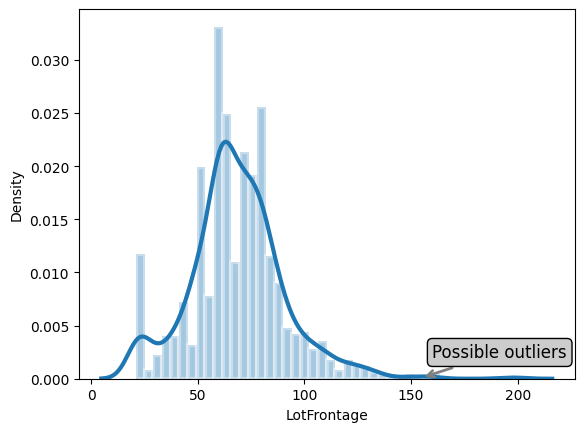

In [236]:
ax = sns.distplot(test_df["LotFrontage"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})

# notation indicating a possible outlier
ax.annotate('Possible outliers', xy=(155, 0.00010), xytext=(160, 0.0020), fontsize=12,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox=dict(boxstyle="round", fc="0.8"))


Text(0.1, 10, 'Outliers')

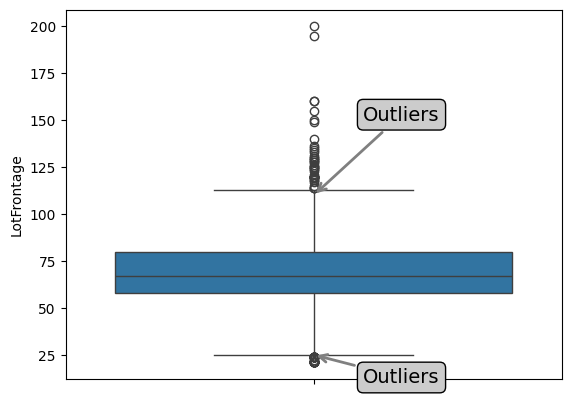

In [237]:
ax = sns.boxplot(test_df["LotFrontage"])

# notation indicating an outlier
ax.annotate('Outliers', xy=(0,110), xytext=(0.1,150), fontsize=14,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox = dict(boxstyle="round", fc="0.8"))

ax.annotate('Outliers', xy=(0,25), xytext=(0.1,10), fontsize=14,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox = dict(boxstyle="round", fc="0.8"))




In [238]:
values = {
    "LotFrontage" : test_df["LotFrontage"][((test_df["LotFrontage"] >= 25.0) & test_df["LotFrontage"] <= 110.0)].mean(),
}
test_df.fillna(values,inplace=True)

MasVnrArea

C:\Users\kevin\AppData\Local\Temp\ipykernel_2760\3157288858.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(test_df["MasVnrArea"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})


Text(585, 0.002, 'Possible outliers')

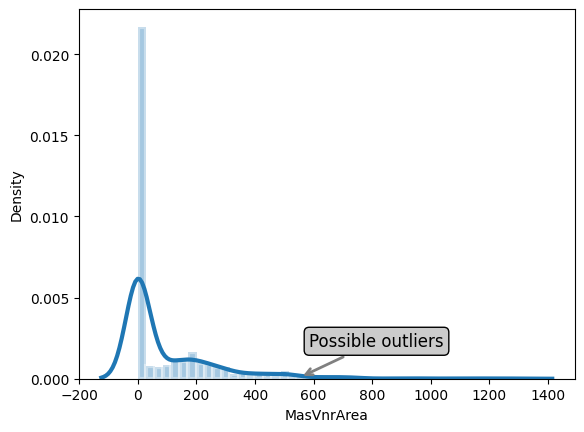

In [239]:
ax = sns.distplot(test_df["MasVnrArea"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})

# notation indicating a possible outlier
ax.annotate('Possible outliers', xy=(555, 0.00010), xytext=(585, 0.0020), fontsize=12,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox=dict(boxstyle="round", fc="0.8"))

Text(0.1, 430, 'Outliers')

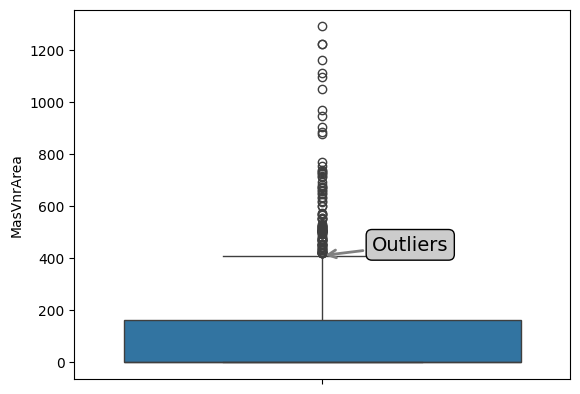

In [240]:
ax = sns.boxplot(test_df["MasVnrArea"])

# notation indicating an outlier
ax.annotate('Outliers', xy=(0,410), xytext=(0.1,430), fontsize=14,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox = dict(boxstyle="round", fc="0.8"))

In [241]:
values = {
    "MasVnrArea" : test_df["MasVnrArea"][((test_df["MasVnrArea"] <= 410.0))].mean(),
}
test_df.fillna(values,inplace=True)

Dropping cols with high NaN concentration

In [242]:
test_df.drop(drop_cols,axis=1,inplace=True)
test_df.drop(["Id"],axis=1,inplace=True)
test_df.reset_index(drop=True,inplace=True)

## Categorical Feature Encoding & Ordinal Encoding

In [258]:
def preprocess_test_df(df,df_type = 3):

    ordinal_cols_ordered = ["LotShape", "Utilities", "LandSlope", "HeatingQC"]
    ordinal_cols_unordered = ["HouseStyle", "ExterQual", "ExterCond","BsmtQual", "BsmtCond", "BsmtExposure",
    "BsmtFinType1", "BsmtFinType2","Electrical", "KitchenQual", "Functional", "FireplaceQu", "GarageFinish", "GarageQual",
    "GarageCond" ]

    new_feat_col_names = []

    # Nominal feature encoding

    for col_name in df.select_dtypes(["object"]).drop(ordinal_cols_ordered + ordinal_cols_unordered,axis = 1).columns.values:
        new_feat_name = col_name + "_enc"
        x = LabelEncoder().fit_transform(df[col_name])
        temp_serie = pd.Series(x,name=new_feat_name)
        df = pd.concat([df,temp_serie],axis=1)
        df.drop([col_name],axis = 1,inplace=True)
        new_feat_col_names.append(new_feat_name)

    #Ordinal categorical encoding (ordered values)

    for col_name in df[ordinal_cols_ordered].columns.values:
        feat = df[col_name]
        cat_len = feat.unique().shape[0]

        #construct dict of values to be replaced
        temp_dic = {}
        for i,val in enumerate(feat.unique()):
            temp_dic[val] = cat_len - i

        #replace dict of values in col features
        temp_serie = feat.replace(temp_dic)
        temp_serie.name = col_name + "_enc"
        df = pd.concat([df,temp_serie],axis=1)
        df.drop([col_name],axis = 1,inplace=True)
        new_feat_col_names.append(temp_serie.name)


    #Ordinal categorical encoding (unordered values)
    ls_replace_vals_ord_cat_unordered = [
    { "1Story" : 1,"1.5Fin" : 2, "1.5Unf" : 3, "2Story" : 4, "2.5Fin" : 5, "2.5Unf" : 6, "SFoyer" : 7,
                            "SLvl" : 8
    },#ord_cat_unordered_hs
    {"Ex" : 5, "Gd" : 4, "TA" : 3, "Fa" : 2, "Po" : 1} , #ord_cat_unordered_eq
    {"Ex" : 5, "Gd" : 4, "TA" : 3, "Fa" : 2, "Po" : 1}, #ord_cat_unordered_ec
    {"Ex" : 5, "Gd" : 4, "TA" : 3, "Fa" : 2, "Po" : 1, "NoBasement" : 0}, #ord_cat_unordered_bq
    {"Ex" : 5, "Gd" : 4, "TA" : 3, "Fa" : 2, "Po" : 1, "NoBasement" : 0}, #ord_cat_unordered_bc
    {"Gd" : 4, "Av" : 3, "Mn" : 2, "No" : 1, "NoBasement" : 0}, #ord_cat_unordered_be
    {"GLQ" : 6 , "ALQ" : 5, "BLQ" : 4, "Rec" : 3, "LwQ" : 2, "Unf" : 1, "NoBasement" : 0}, #ord_cat_unordered_bft1
    {"GLQ" : 6 , "ALQ" : 5, "BLQ" : 4, "Rec" : 3, "LwQ" : 2, "Unf" : 1, "NoBasement" : 0}, #ord_cat_unordered_bft2
    {"SBrkr" : 5, "FuseA" : 4, "FuseF" : 3, "FuseP" : 2, "Mix" : 1}, #ord_cat_unordered_e
    {"Ex" : 5, "Gd" : 4, "TA" : 3, "Fa" : 2, "Po" : 1}, #ord_cat_unordered_kq
    {"Typ" : 7, "Min1" : 6, "Min2" : 5, "Mod" : 4, "Maj1" : 3, "Maj2" : 2, "Sev" : 1}, #ord_cat_unordered_f
    {'Ex': 5, 'Gd' : 4, 'TA' : 3, "Fa" : 2, 'Po' : 1, 'NoFireplace' : 0}, #ord_cat_unordered_fq
    {'Fin' : 3, 'RFn' : 2, 'Unf' : 1, 'NoGarage' : 0}, #ord_cat_unordered_gf
    {"Ex" : 5, "Gd" : 4, "TA" : 3, "Fa" : 2, "Po" : 1, "NoGarage" : 0}, #ord_cat_unordered_gq
    {"Ex" : 5, "Gd" : 4, "TA" : 3, "Fa" : 2, "Po" : 1, "NoGarage" : 0} #ord_cat_unordered_gc
    ]

    for i,col_name in enumerate(df[ordinal_cols_unordered].columns.values):

        #replace dict of values in col features
        temp_serie = df[col_name].replace(ls_replace_vals_ord_cat_unordered[i])
        temp_serie.name = col_name + "_enc"
        df = pd.concat([df,temp_serie],axis=1)
        df.drop([col_name],axis = 1,inplace=True)
        new_feat_col_names.append(temp_serie.name)


    int_float_features = df.columns.drop(new_feat_col_names).tolist()
    df = df[new_feat_col_names + int_float_features]

    """ #keep relevant features according to the feature selection process
    shap_feat_names = ["OverallQual","GrLivArea","GarageCars","YearBuilt","YearRemodAdd","TotalBsmtSF","OverallCond","GarageType_enc",
                       "BsmtFinSF1","LotArea","ExterQual_enc","GarageArea","1stFlrSF","BsmtFinType1_enc","Neighborhood_enc", "Fireplaces", 
                       "KitchenQual_enc","SaleCondition_enc","GarageYrBlt"]
    if df_type == 4:
        shap_feat_names = shap_feat_names + ["CentralAir_enc","OpenPorchSF","MSZoning_enc","WoodDeckSF","Exterior1st_enc","BsmtQual_enc",
                                             "BsmtExposure_enc","LotFrontage"]
        
    return df[shap_feat_names] """
    return df



In [37]:
fs_4_test_df = preprocess_test_df(test_df.copy(),4)

## Prepare Test Datasets

In [259]:
X_new_ord_enc_w_outliers_test = preprocess_test_df(test_df.copy()).to_numpy()

C:\Users\kevin\AppData\Local\Temp\ipykernel_2760\2343498052.py:32: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  temp_serie = feat.replace(temp_dic)
C:\Users\kevin\AppData\Local\Temp\ipykernel_2760\2343498052.py:32: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  temp_serie = feat.replace(temp_dic)
C:\Users\kevin\AppData\Local\Temp\ipykernel_2760\2343498052.py:32: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(c

## Predict Datasets

Shapley Feature Selection DF 4 - XGBREGRESSOR

In [266]:
y_pred_new_ord_enc_w_outliers_test = gs_w_outliers_new_ord_enc.predict(X_new_ord_enc_w_outliers_test)
y_pred_new_ord_enc_w_outliers_test = np.exp(y_pred_new_ord_enc_w_outliers_test)

## Save Submission predictions to csv

In [261]:
from datetime import datetime

In [268]:
path = "./data/submissions/August-2024/"
empty_cols = {
    "Id" : np.arange(1461,1461 + fs_4_test_df.shape[0]),
    "SalePrice" : np.zeros([fs_4_test_df.shape[0],],dtype=float)
}

fs_4_test_submission = pd.DataFrame(empty_cols)

fs_4_test_submission["SalePrice"] = y_pred_new_ord_enc_w_outliers_test

now = datetime.now()
dt_string = now.strftime("%d_%m_%Y-%H_%M_%S")

model_name = "test_new_ord_enc_wo_outliers" + "_"
fs_4_test_submission.to_csv(path+ model_name + dt_string + ".csv",index=False)